In [265]:
import polars as pl
import seaborn as sns
import matplotlib.pyplot as plt
from plotnine import *
from plotnine.options import set_option

In [266]:
def auc_barplot(df: pl.DataFrame, x_col: str, y_col: str, model_col: str, facet_col: str, title: str = None, subtitle: str = None, x_axis_label: str = None, y_axis_label: str = None, text_scale: float = 1, legend_rows: int = 1) -> ggplot:
    
    p = (
		ggplot(df, aes(x=x_col, y=y_col, fill=model_col))
		+ geom_col(position=position_dodge(), color="black")
		+ facet_wrap(facet_col, ncol=1, scales="free_x")
		+ labs(
			title = title,
			subtitle = subtitle,
			x = x_axis_label,
			y = y_axis_label
		)
		+ theme_minimal()
		+ theme(
			axis_text_x=element_text(size=8*text_scale, angle=30, hjust = 1, vjust = 1),
			axis_ticks=element_line(),
			plot_title=element_text(size=20*text_scale, face="bold", margin = {'t': 5*text_scale}, hjust=0.5),
			plot_subtitle=element_text(margin = {'b': 10*text_scale}, hjust=0.5),
			axis_title_x=element_text(size=16*text_scale),
			axis_title_y=element_text(size=16*text_scale),
			axis_text_y=element_text(size=12*text_scale),
			legend_title=element_blank(),
			legend_text=element_text(size=12*text_scale),
			strip_text=element_text(size=14*text_scale),
			panel_grid_major=element_blank(),
			panel_grid_minor=element_blank(),
			# Positioning
			legend_position = "bottom",
			legend_key_size = 15*text_scale,
		)
		+ guides(fill=guide_legend(nrow=legend_rows))
		+ scale_y_continuous(limits=(0, 1))
	)
    
    return p

In [267]:
stylized_model_names = {
	"microsec" : "MicroSEC",
	"mobsnvf" : "MOBSNVF",
	"vafsnvf" : "VAFSNVF",
	"sobdetector" : "SOBDetector",
	"gatk-obmm": "GATK-OBMM"
}

stylized_vcaller_names = {
	"muse" : "MuSE",
	"mutect2" : "MuTect2",
	"somaticsniper" : "SomaticSniper",
	"varscan2" : "VarScan2"
}


### TCGA

In [268]:
tcga_annot = pl.read_csv("../../analysis-tcga-ffpe/gdc/annot2/vcf_annotation.tsv", separator="\t")

#### Filtered FFPE VCF vs Filtered Fresh-Frozen VCF | C:G>T:A SNVs only

sample_name,model,auroc,auprc,wtype
str,str,f64,f64,str
"""03670742-50ed-4212-b566-784e1d…","""MOBSNVF""",0.667319,0.841781,"""MuSE"""
"""03670742-50ed-4212-b566-784e1d…","""SOBDetector""",0.708415,0.86878,"""MuSE"""
"""03670742-50ed-4212-b566-784e1d…","""VAFSNVF""",0.488258,0.795134,"""MuSE"""
"""066565d1-104d-4f18-ab2a-406cf8…","""MOBSNVF""",0.978495,0.995863,"""MuSE"""
"""066565d1-104d-4f18-ab2a-406cf8…","""SOBDetector""",0.755376,0.893288,"""MuSE"""
…,…,…,…,…
"""fe1d1217-b8cf-455b-a89c-d259e4…","""SOBDetector""",0.580599,0.655703,"""VarScan2"""
"""fe1d1217-b8cf-455b-a89c-d259e4…","""VAFSNVF""",0.680469,0.773855,"""VarScan2"""
"""ff173879-8fbb-4f7b-848d-a77048…","""MOBSNVF""",0.846613,0.453206,"""VarScan2"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 16 x 16 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: tcga.auroc.barplot.matched.f-ffpe_f-ff.ct-snvs.pdf


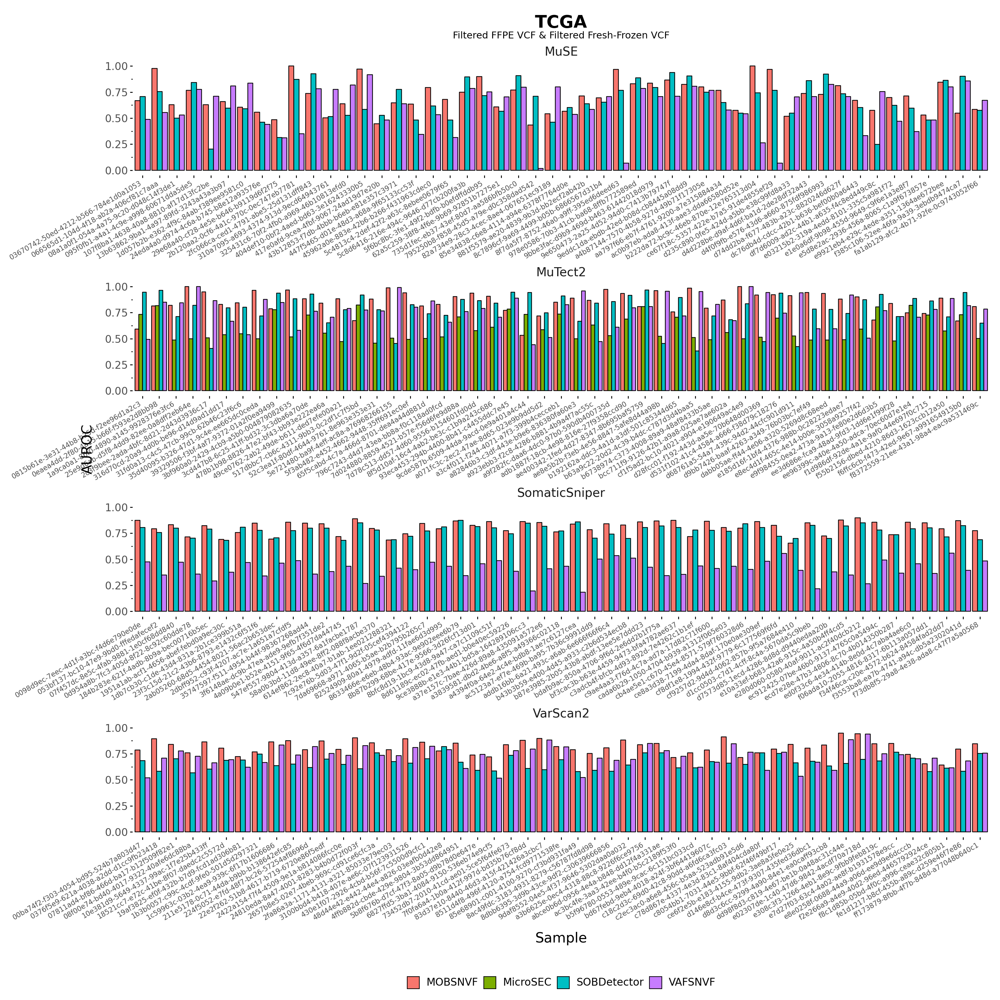

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 16 x 16 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: tcga.auprc.barplot.matched.f-ffpe_f-ff.ct-snvs.pdf


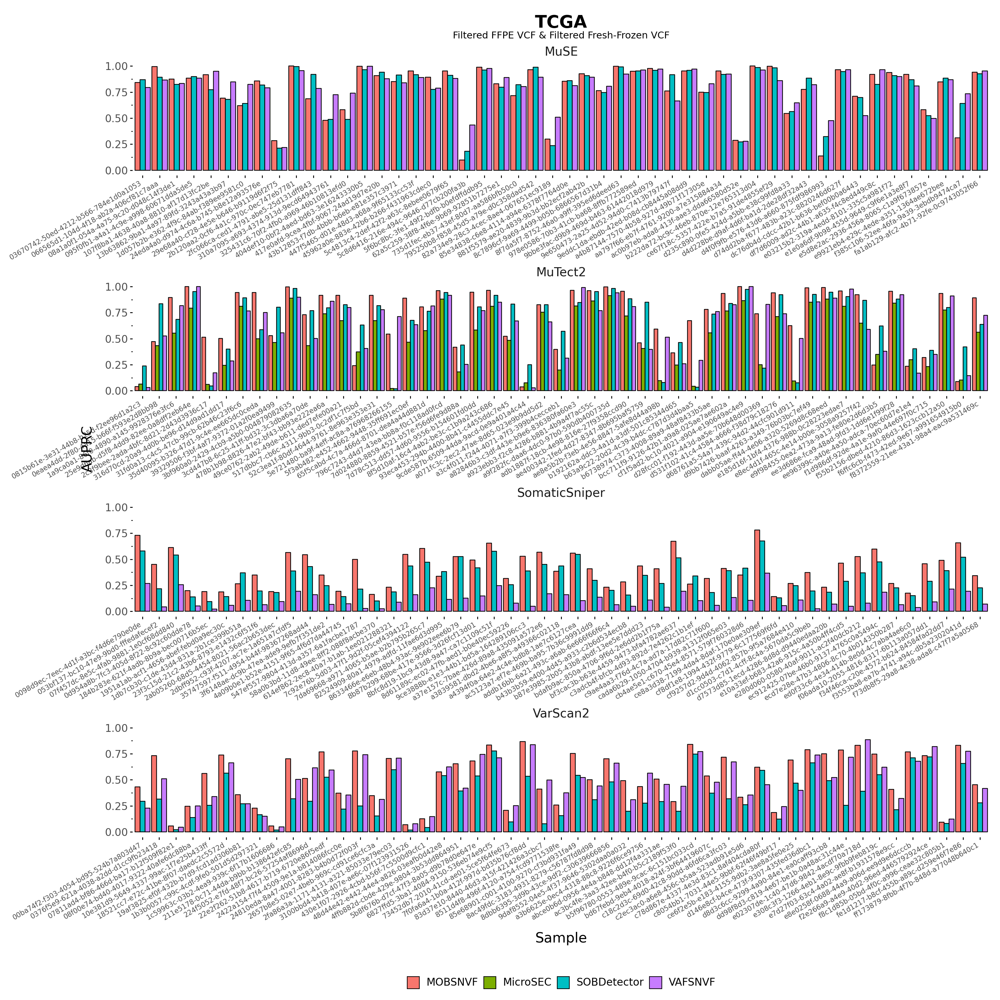

In [269]:
paths = [
	"tcga/tcga.muse.matched.f-ffpe_f-ff.ct-snvs.tsv",
	"tcga/tcga.mutect2.matched.f-ffpe_f-ff.ct-snvs.tsv",
	"tcga/tcga.somaticsniper.matched.f-ffpe_f-ff.ct-snvs.tsv",
	"tcga/tcga.varscan2.matched.f-ffpe_f-ff.ct-snvs.tsv"
]

tcga_matched_f_f_ct = []

for path in paths:

	tcga_matched_f_f_ct_caller = pl.read_csv(path, separator="\t").with_columns(wtype=pl.lit(stylized_vcaller_names.get(path.split(".")[1], path.split(".")[1])))
	tcga_matched_f_f_ct.append(tcga_matched_f_f_ct_caller)

tcga_matched_f_f_ct = pl.concat(tcga_matched_f_f_ct)
tcga_matched_f_f_ct = tcga_matched_f_f_ct.with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
tcga_matched_f_f_ct = tcga_matched_f_f_ct.filter(~pl.col("sample_name").str.contains("all-"))

tcga_matched_f_f_ct.write_csv("tcga/tcga.matched.f-ffpe_f-ff.ct-snvs.tsv", separator="\t")

display(tcga_matched_f_f_ct)

set_option("figure_size", (16, 16))

tcga_matched_f_f_ct_auroc_barplot = auc_barplot(
	tcga_matched_f_f_ct,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "TCGA",
	subtitle = "Filtered FFPE VCF & Filtered Fresh-Frozen VCF",
	x_axis_label="Sample",
	y_axis_label="AUROC"
)

tcga_matched_f_f_ct_auroc_barplot.save("tcga.auroc.barplot.matched.f-ffpe_f-ff.ct-snvs.pdf")
display(tcga_matched_f_f_ct_auroc_barplot)


tcga_matched_f_f_ct_auprc_barplot = auc_barplot(
	tcga_matched_f_f_ct,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "TCGA",
	subtitle = "Filtered FFPE VCF & Filtered Fresh-Frozen VCF",
	x_axis_label="Sample",
	y_axis_label="AUPRC"
)

tcga_matched_f_f_ct_auprc_barplot.save("tcga.auprc.barplot.matched.f-ffpe_f-ff.ct-snvs.pdf")
tcga_matched_f_f_ct_auprc_barplot

#### Filtered FFPE VCF vs Filtered Fresh-Frozen VCF | All SNVs

In [270]:
tcga_matched_f_f_all = pl.read_csv("tcga/tcga.matched.f-ffpe_f-ff.all-snvs.tsv", separator="\t").filter(~pl.col("sample_name").str.contains("all-"))
tcga_matched_f_f_all

sample_name,model,auroc,auprc,workflow_type,workflow_type_right
str,str,f64,f64,str,str
"""0098d9ec-7eec-4d1f-a3bc-f4d6e7…","""MicroSEC""",0.514054,0.24679,"""SomaticSniper""","""SomaticSniper"""
"""0098d9ec-7eec-4d1f-a3bc-f4d6e7…","""MOBSNVF""",0.871851,0.731155,"""SomaticSniper""","""SomaticSniper"""
"""0098d9ec-7eec-4d1f-a3bc-f4d6e7…","""SOBDetector""",0.77897,0.561955,"""SomaticSniper""","""SomaticSniper"""
"""0098d9ec-7eec-4d1f-a3bc-f4d6e7…","""VAFSNVF""",0.471786,0.26878,"""SomaticSniper""","""SomaticSniper"""
"""00ba74f2-f303-4054-bd95-524b7a…","""MicroSEC""",0.674495,0.345319,"""VarScan2""","""VarScan2"""
…,…,…,…,…,…
"""fe1d1217-b8cf-455b-a89c-d259e4…","""VAFSNVF""",0.680469,0.773855,"""VarScan2""","""VarScan2"""
"""ff173879-8fbb-4f7b-848d-a77048…","""MicroSEC""",0.568819,0.202719,"""VarScan2""","""VarScan2"""
"""ff173879-8fbb-4f7b-848d-a77048…","""MOBSNVF""",0.846613,0.453206,"""VarScan2""","""VarScan2"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 16 x 16 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: tcga.auroc.barplot.matched.f-ffpe_f-ff.all-snvs.pdf


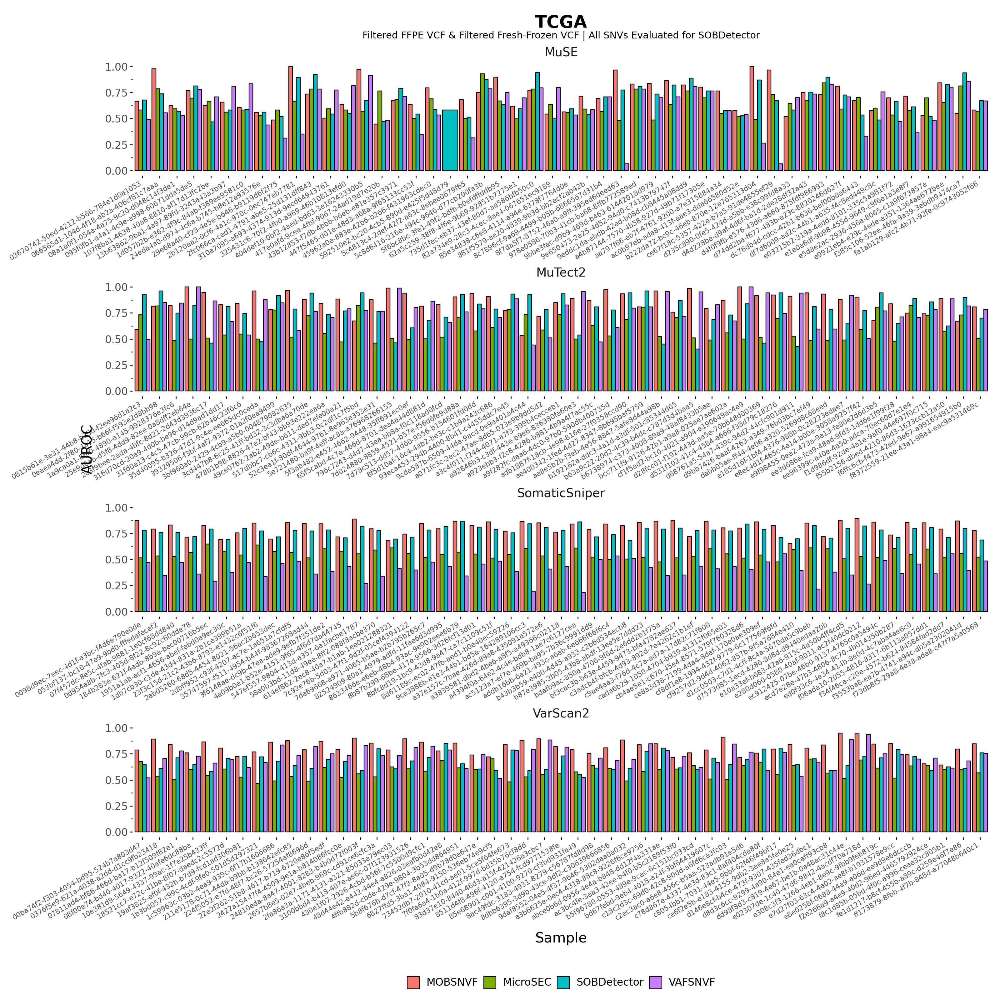

In [271]:
set_option("figure_size", (16, 16))

tcga_matched_f_f_all_barplot = auc_barplot(
	tcga_matched_f_f_all,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="workflow_type",
	title = "TCGA",
	subtitle = "Filtered FFPE VCF & Filtered Fresh-Frozen VCF | All SNVs Evaluated for SOBDetector",
	x_axis_label="Sample",
	y_axis_label="AUROC"
)
tcga_matched_f_f_all_barplot.save("tcga.auroc.barplot.matched.f-ffpe_f-ff.all-snvs.pdf")
tcga_matched_f_f_all_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 16 x 16 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: tcga.auprc.barplot.matched.f-ffpe_f-ff.all-snvs.pdf


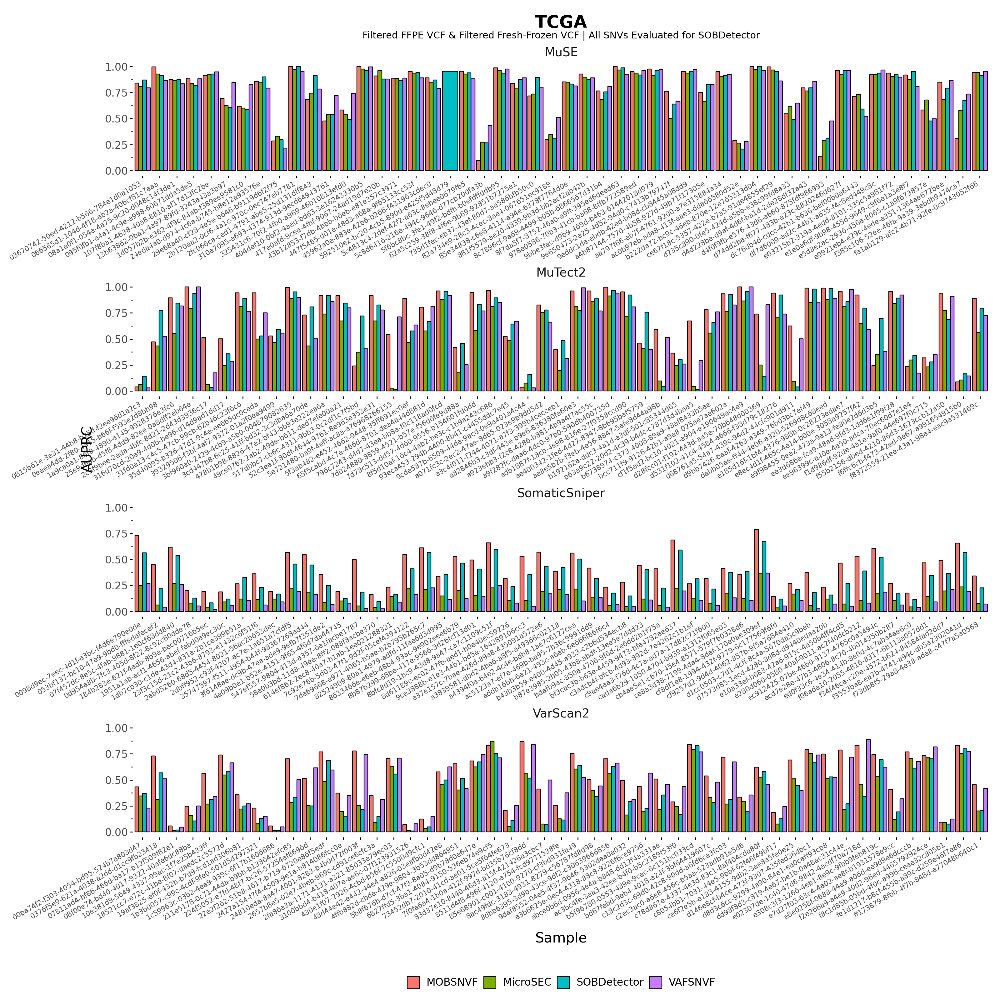

In [272]:
set_option("figure_size", (16, 16))

tcga_matched_f_f_all_barplot = auc_barplot(
	tcga_matched_f_f_all,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="workflow_type",
	title = "TCGA",
	subtitle = "Filtered FFPE VCF & Filtered Fresh-Frozen VCF | All SNVs Evaluated for SOBDetector",
	x_axis_label="Sample",
	y_axis_label="AUPRC"
)
tcga_matched_f_f_all_barplot.save("tcga.auprc.barplot.matched.f-ffpe_f-ff.all-snvs.pdf")
tcga_matched_f_f_all_barplot

#### Unfiltered FFPE VCF vs Unfiltered Fresh-Frozen VCF | All SNVs

In [273]:
tcga_matched_uf_uf_ct = (
    pl.read_csv("tcga/tcga.matched.uf-ffpe_uf-ff.ct-snvs.tsv", separator="\t")
    .filter(~pl.col("vcf_fid").str.contains("all-"))
    .with_columns(pl.col("wtype").map_elements(lambda x : stylized_vcaller_names.get(x, x), return_dtype=str))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)
tcga_matched_uf_uf_ct

case_id,wtype,vcf_fid,model,auroc,auprc
str,str,str,str,f64,f64
"""011b9b2d-ebe5-42bf-9662-d922fa…","""MuSE""","""095f0fb1-a4a1-4c9e-a998-60671d…","""MOBSNVF""",0.928824,0.846436
"""011b9b2d-ebe5-42bf-9662-d922fa…","""MuSE""","""095f0fb1-a4a1-4c9e-a998-60671d…","""VAFSNVF""",0.912502,0.83826
"""011b9b2d-ebe5-42bf-9662-d922fa…","""MuSE""","""095f0fb1-a4a1-4c9e-a998-60671d…","""SOBDetector""",0.856998,0.644
"""011b9b2d-ebe5-42bf-9662-d922fa…","""MuSE""","""095f0fb1-a4a1-4c9e-a998-60671d…","""MicroSEC""",0.645241,0.433745
"""011b9b2d-ebe5-42bf-9662-d922fa…","""MuSE""","""43b12853-f7db-4bbb-b6eb-e81e35…","""MOBSNVF""",0.920271,0.83754
…,…,…,…,…,…
"""fb79c491-7b01-42ae-8369-8364e4…","""VarScan2""","""10e381d9-5649-4337-99ac-1f7e25…","""MicroSEC""",0.543436,0.267653
"""fb79c491-7b01-42ae-8369-8364e4…","""VarScan2""","""9daf8552-04e5-4f37-9646-5302da…","""MOBSNVF""",0.914845,0.544648
"""fb79c491-7b01-42ae-8369-8364e4…","""VarScan2""","""9daf8552-04e5-4f37-9646-5302da…","""VAFSNVF""",0.713144,0.332428


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 16 x 16 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: tcga.auroc.barplot.matched.uf-ffpe_uf-ff.ct-snvs.pdf


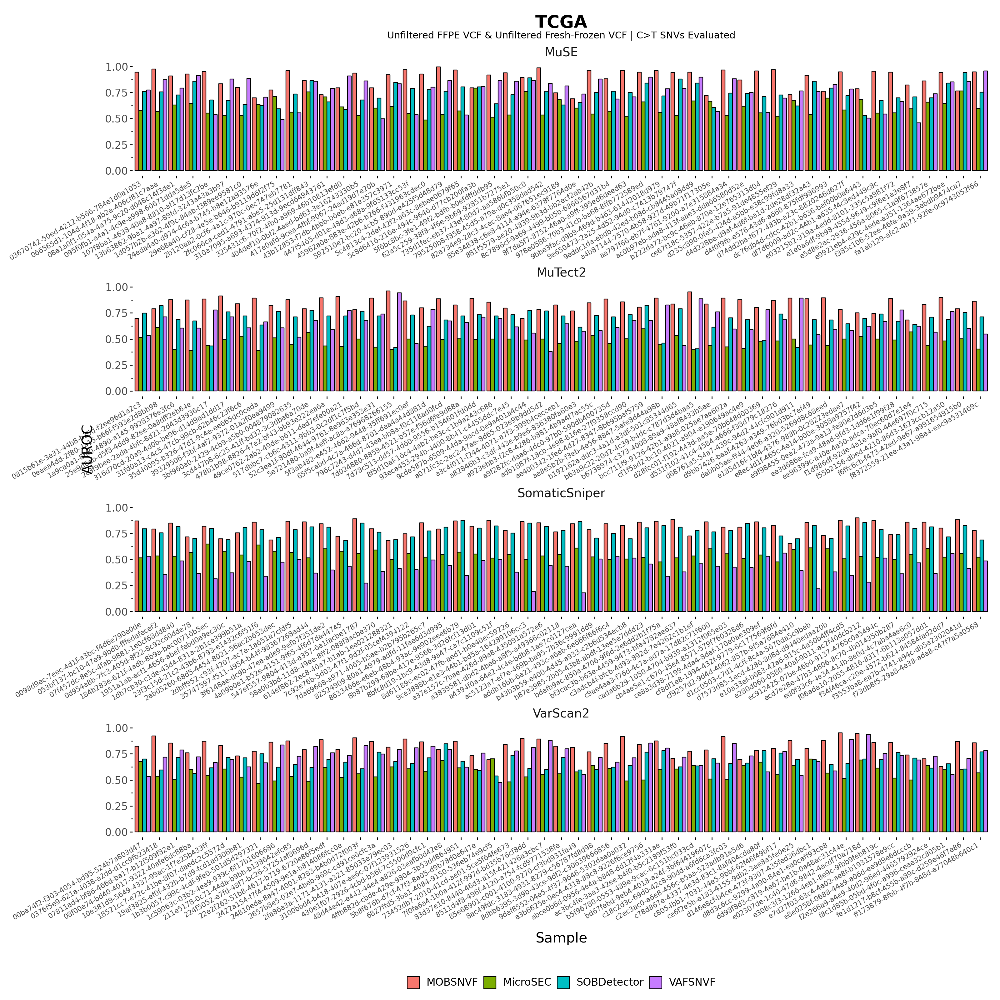

In [274]:
set_option("figure_size", (16, 16))

tcga_matched_uf_uf_ct_barplot = auc_barplot(
	tcga_matched_uf_uf_ct,
	x_col="vcf_fid",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "TCGA",
	subtitle = "Unfiltered FFPE VCF & Unfiltered Fresh-Frozen VCF | C>T SNVs Evaluated",
	x_axis_label="Sample",
	y_axis_label="AUROC"
)
tcga_matched_uf_uf_ct_barplot.save("tcga.auroc.barplot.matched.uf-ffpe_uf-ff.ct-snvs.pdf")
tcga_matched_uf_uf_ct_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 16 x 16 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: tcga.auprc.barplot.matched.uf-ffpe_uf-ff.ct-snvs.pdf


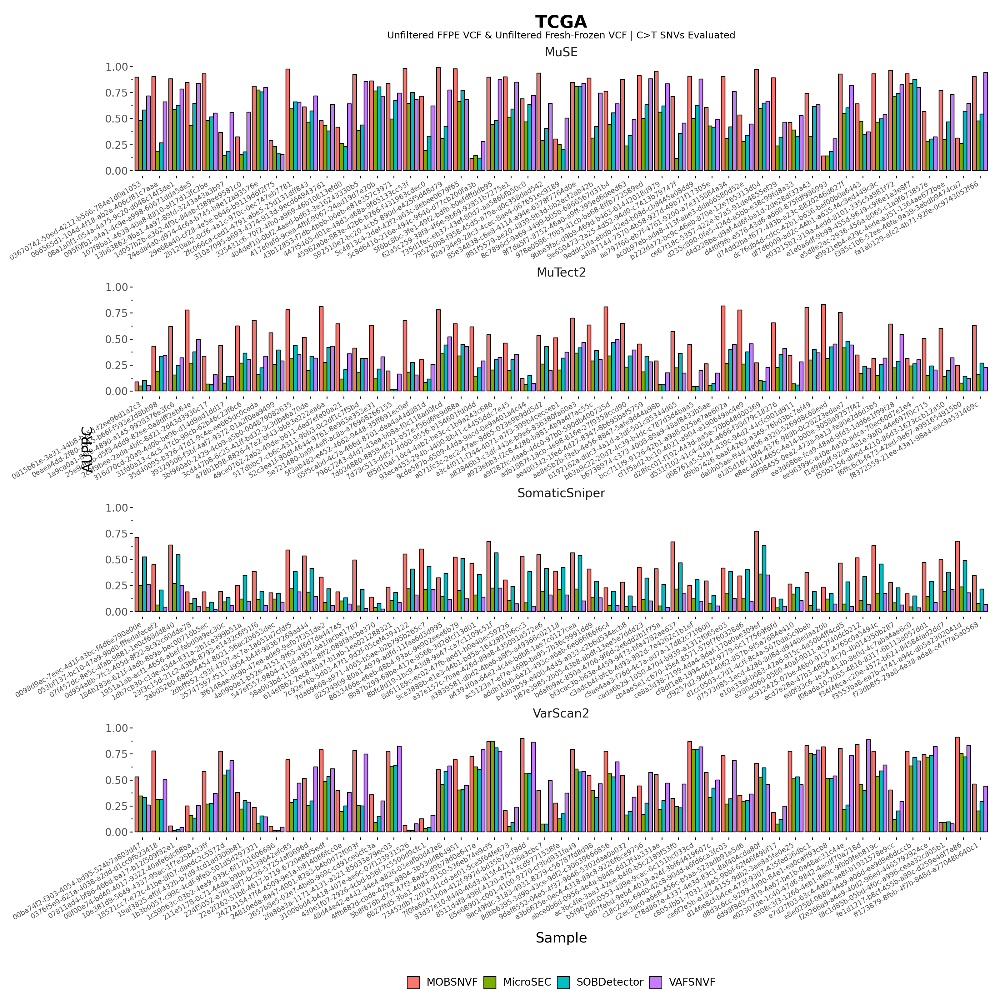

In [275]:
set_option("figure_size", (16, 16))

tcga_matched_uf_uf_ct_barplot = auc_barplot(
	tcga_matched_uf_uf_ct,
	x_col="vcf_fid",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "TCGA",
	subtitle = "Unfiltered FFPE VCF & Unfiltered Fresh-Frozen VCF | C>T SNVs Evaluated",
	x_axis_label="Sample",
	y_axis_label="AUPRC"
)
tcga_matched_uf_uf_ct_barplot.save("tcga.auprc.barplot.matched.uf-ffpe_uf-ff.ct-snvs.pdf")
tcga_matched_uf_uf_ct_barplot

### ENA

#### ENA PRJEB8754

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ena.PRJEB8754.auroc.barplot.tumor-only.f-ffpe_f-ff.pdf


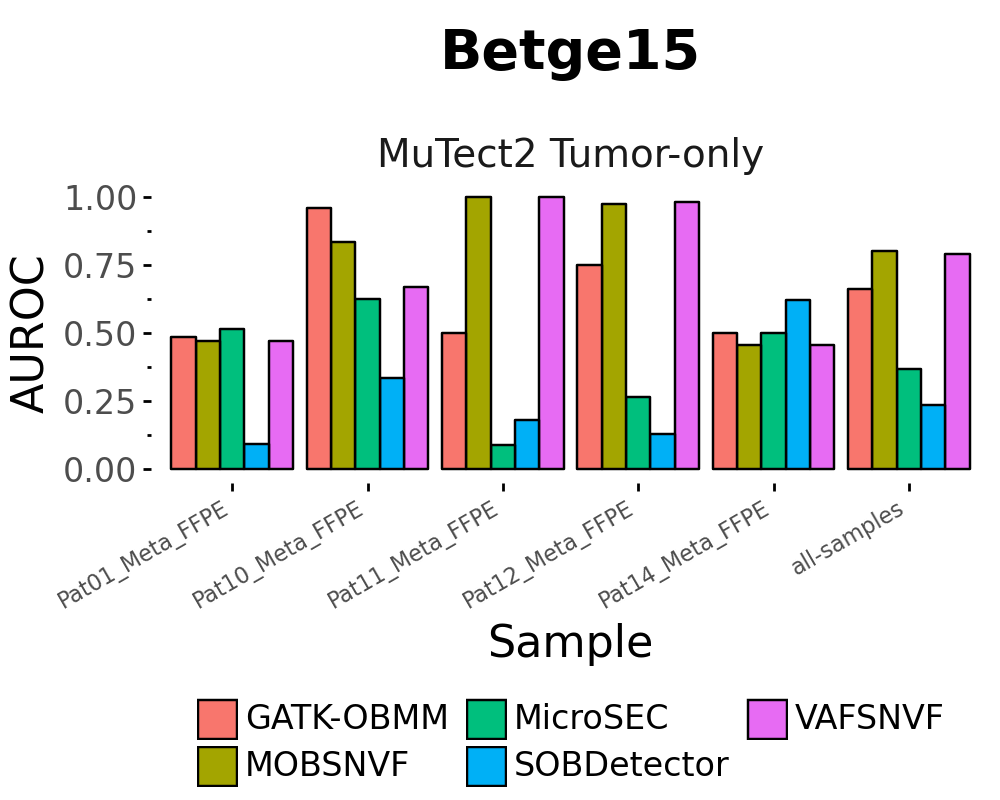

In [276]:
ena_PRJEB8754_f_f_ct_aucs =  (
    pl.read_csv("ena_PRJEB8754/ena.PRJEB8754.tumor-only.f-ffpe_f-ff.tsv", separator="\t")
    .with_columns(wtype = pl.lit("MuTect2 Tumor-only"))
    # .filter(~pl.col("sample_name").str.contains("all-"))
    .with_columns(sample_name=pl.col("sample_name").map_elements(lambda x : "_".join(x.split("_")[:3]), return_dtype=str))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)

set_option("figure_size", (5, 4))

ena_PRJEB8754_f_f_ct_auroc_barplot = auc_barplot(
	ena_PRJEB8754_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "Betge15",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUROC",
	text_scale=1,
	legend_rows=2
)
ena_PRJEB8754_f_f_ct_auroc_barplot.save("ena.PRJEB8754.auroc.barplot.tumor-only.f-ffpe_f-ff.pdf")
ena_PRJEB8754_f_f_ct_auroc_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ena.PRJEB8754.auprc.barplot.tumor-only.f-ffpe_f-ff.pdf


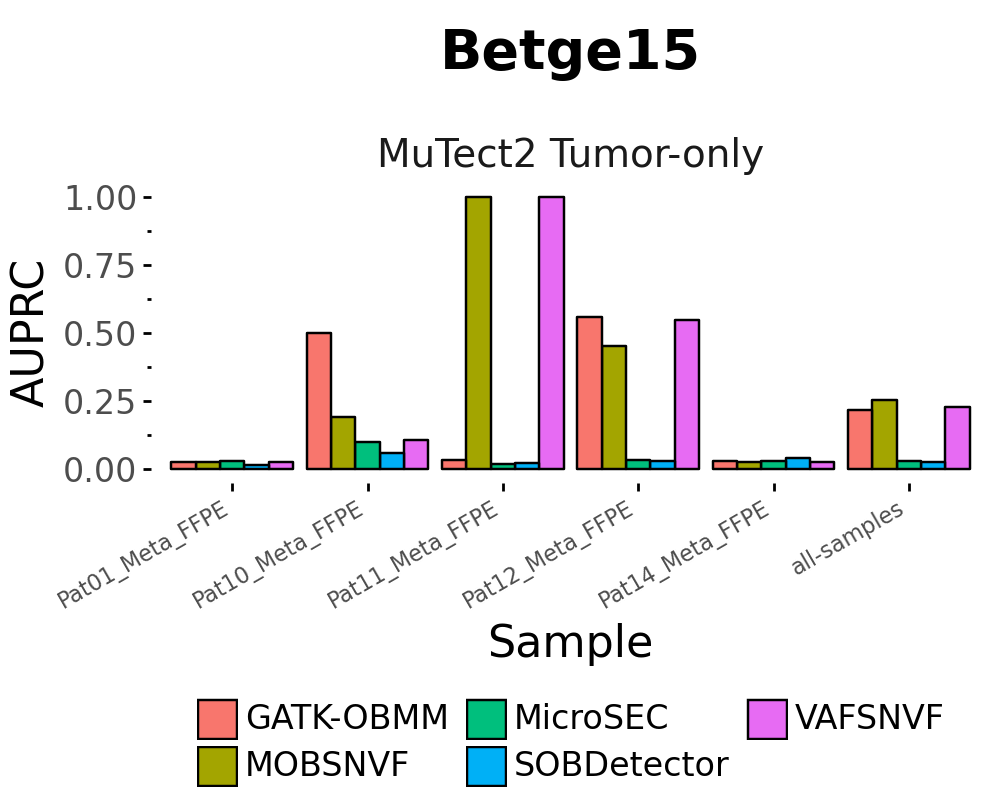

In [277]:
ena_PRJEB8754_f_f_ct_auprc_barplot = auc_barplot(
	ena_PRJEB8754_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "Betge15",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUPRC",
	text_scale=1,
	legend_rows=2
)

ena_PRJEB8754_f_f_ct_auprc_barplot.save("ena.PRJEB8754.auprc.barplot.tumor-only.f-ffpe_f-ff.pdf")
ena_PRJEB8754_f_f_ct_auprc_barplot

sample_name,model,auroc,auprc,wtype
str,str,f64,f64,str
"""all-samples""","""GATK-OBMM""",0.501214,0.008479,"""MuTect2 Tumor-only"""
"""all-samples""","""MicroSEC""",0.572316,0.011167,"""MuTect2 Tumor-only"""
"""all-samples""","""MOBSNVF""",0.759638,0.194106,"""MuTect2 Tumor-only"""
"""all-samples""","""SOBDetector""",0.661887,0.017217,"""MuTect2 Tumor-only"""
"""all-samples""","""VAFSNVF""",0.479147,0.008122,"""MuTect2 Tumor-only"""
…,…,…,…,…
"""Sample_B83_0032""","""GATK-OBMM""",0.500955,0.011676,"""MuTect2 Tumor-only"""
"""Sample_B83_0032""","""MicroSEC""",0.54939,0.013379,"""MuTect2 Tumor-only"""
"""Sample_B83_0032""","""MOBSNVF""",0.740496,0.239902,"""MuTect2 Tumor-only"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ena.PRJEB44073.auroc.barplot.tumor-only.f-ffpe_f-ff.pdf


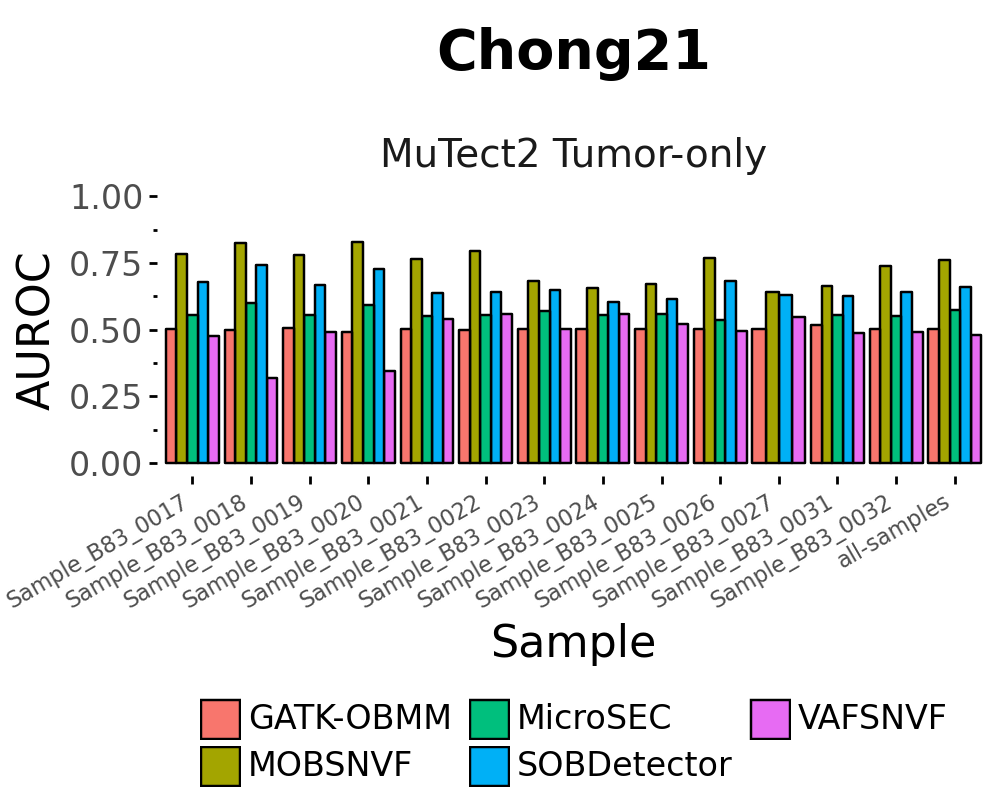

In [278]:
ena_PRJEB44073_f_f_ct_aucs =  (
    pl.read_csv("ena_PRJEB44073/ena.PRJEB44073.tumor-only.f-ffpe_f-ff.tsv", separator="\t")
    .with_columns(wtype = pl.lit("MuTect2 Tumor-only"))
    # .filter(~pl.col("sample_name").str.contains("all-"))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)

display(ena_PRJEB44073_f_f_ct_aucs)

set_option("figure_size", (5, 4))

ena_PRJEB44073_f_f_ct_auroc_barplot = auc_barplot(
	ena_PRJEB44073_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "Chong21",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUROC",
	text_scale=1,
	legend_rows=2
)
ena_PRJEB44073_f_f_ct_auroc_barplot.save("ena.PRJEB44073.auroc.barplot.tumor-only.f-ffpe_f-ff.pdf")
ena_PRJEB44073_f_f_ct_auroc_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ena.PRJEB44073.auprc.barplot.tumor-only.f-ffpe_f-ff.pdf


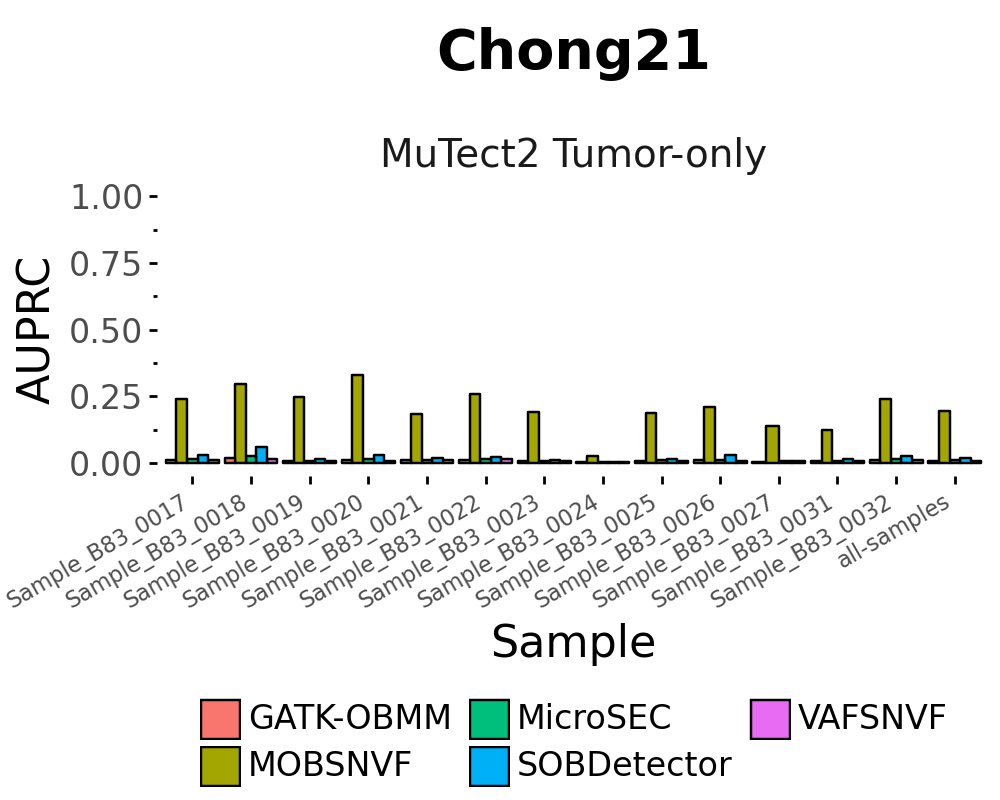

In [279]:
ena_PRJEB44073_f_f_ct_auprc_barplot = auc_barplot(
	ena_PRJEB44073_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "Chong21",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUPRC",
	text_scale=1,
	legend_rows=2
)
ena_PRJEB44073_f_f_ct_auprc_barplot.save("ena.PRJEB44073.auprc.barplot.tumor-only.f-ffpe_f-ff.pdf")
ena_PRJEB44073_f_f_ct_auprc_barplot

sample_name,model,auroc,auprc,wtype
str,str,f64,f64,str
"""all-samples""","""GATK-OBMM""",0.536871,0.001032,"""MuTect2 Tumor-only"""
"""all-samples""","""MicroSEC""",0.563845,0.001567,"""MuTect2 Tumor-only"""
"""all-samples""","""MOBSNVF""",0.789994,0.050244,"""MuTect2 Tumor-only"""
"""all-samples""","""SOBDetector""",0.693675,0.002212,"""MuTect2 Tumor-only"""
"""all-samples""","""VAFSNVF""",0.563506,0.001039,"""MuTect2 Tumor-only"""
…,…,…,…,…
"""BGI-FFPE8_SRR1523262""","""VAFSNVF""",0.583809,0.001123,"""MuTect2 Tumor-only"""
"""BGI-FFPE9_SRR1523255""","""GATK-OBMM""",0.613555,0.002502,"""MuTect2 Tumor-only"""
"""BGI-FFPE9_SRR1523255""","""MOBSNVF""",0.863778,0.309324,"""MuTect2 Tumor-only"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 9 x 5 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ena.SRP044740.auroc.barplot.tumor-only.f-ffpe_f-ff.pdf


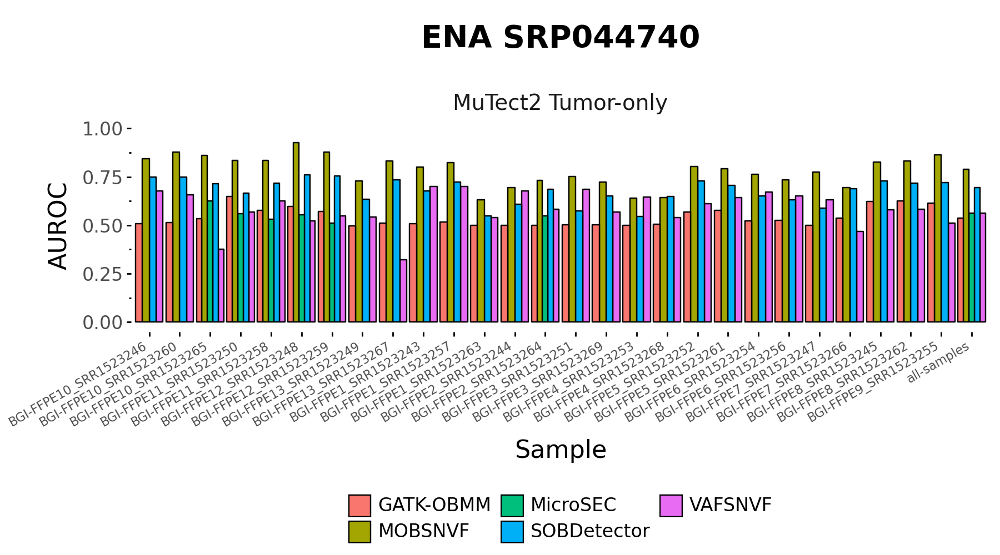

In [280]:
ena_SRP044740_f_f_ct_aucs =  (
    pl.read_csv("ena_SRP044740/ena.SRP044740.tumor-only.f-ffpe_f-ff.tsv", separator="\t")
    .with_columns(wtype = pl.lit("MuTect2 Tumor-only"))
    # .filter(~pl.col("sample_name").str.contains("all-"))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)

display(ena_SRP044740_f_f_ct_aucs)

set_option("figure_size", (9, 5))

ena_SRP044740_f_f_ct_auroc_barplot = auc_barplot(
	ena_SRP044740_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "ENA SRP044740",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUROC",
	text_scale=1,
	legend_rows=2
)

ena_SRP044740_f_f_ct_auroc_barplot.save("ena.SRP044740.auroc.barplot.tumor-only.f-ffpe_f-ff.pdf")
ena_SRP044740_f_f_ct_auroc_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 9 x 5 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ena.SRP044740.auprc.barplot.tumor-only.f-ffpe_f-ff.pdf


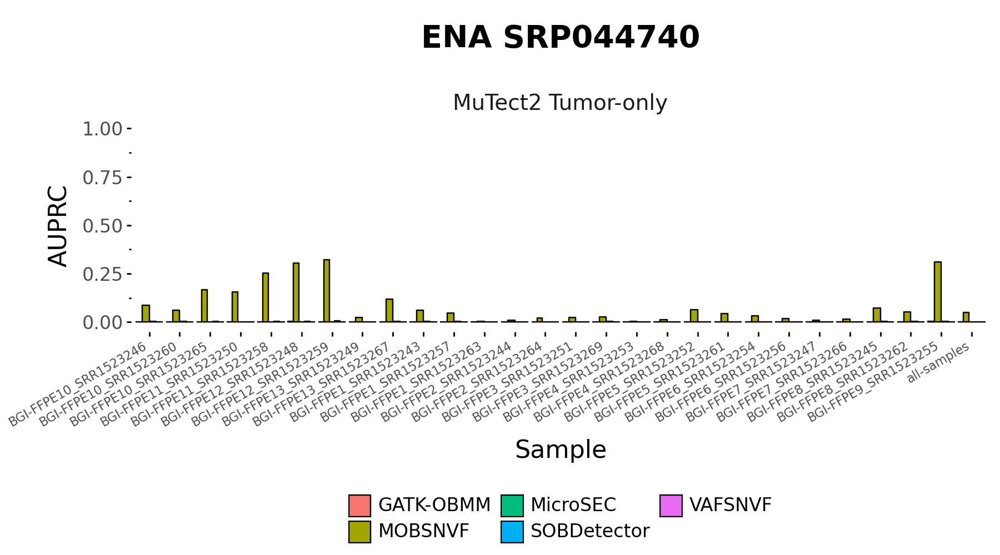

In [281]:
ena_SRP044740_f_f_ct_auprc_barplot = auc_barplot(
	ena_SRP044740_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "ENA SRP044740",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUPRC",
	text_scale=1,
	legend_rows=2
)

ena_SRP044740_f_f_ct_auprc_barplot.save("ena.SRP044740.auprc.barplot.tumor-only.f-ffpe_f-ff.pdf")
ena_SRP044740_f_f_ct_auprc_barplot

sample_name,model,auroc,auprc,wtype
str,str,f64,f64,str
"""all-samples""","""GATK-OBMM""",0.528815,0.002899,"""MuTect2 matched-normal"""
"""all-samples""","""MicroSEC""",0.567939,0.003236,"""MuTect2 matched-normal"""
"""all-samples""","""MOBSNVF""",0.946262,0.141847,"""MuTect2 matched-normal"""
"""all-samples""","""SOBDetector""",0.700191,0.004642,"""MuTect2 matched-normal"""
"""all-samples""","""VAFSNVF""",0.681825,0.0042,"""MuTect2 matched-normal"""
…,…,…,…,…
"""T4_2009_FFPE""","""GATK-OBMM""",0.50111,0.000819,"""MuTect2 matched-normal"""
"""T4_2009_FFPE""","""MicroSEC""",0.560993,0.000979,"""MuTect2 matched-normal"""
"""T4_2009_FFPE""","""MOBSNVF""",0.950692,0.111862,"""MuTect2 matched-normal"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ena.SRP065941.auroc.barplot.matched.f-ffpe_f-ff.pdf


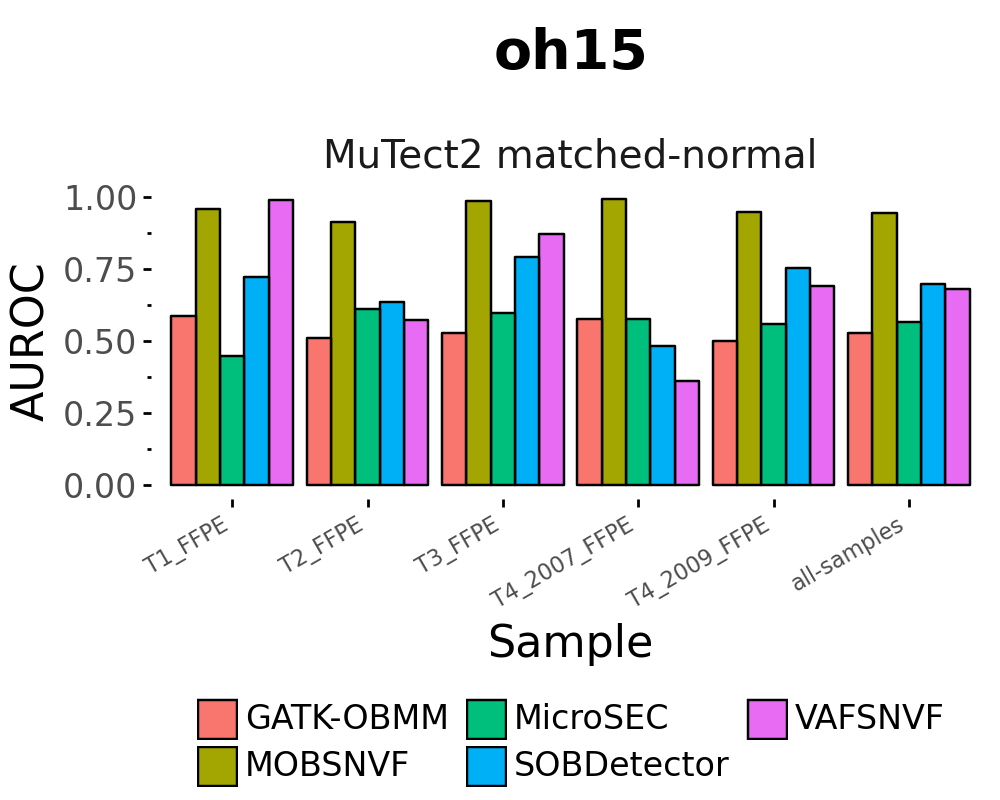

In [282]:
ena_SRP065941_f_f_ct_aucs =  (
    pl.read_csv("ena_SRP065941/ena.SRP065941.matched.f-ffpe_f-ff.tsv", separator="\t")
    .with_columns(wtype = pl.lit("MuTect2 matched-normal"))
    # .filter(~pl.col("sample_name").str.contains("all-"))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)

display(ena_SRP065941_f_f_ct_aucs)

set_option("figure_size", (5, 4))

ena_SRP065941_f_f_ct_auroc_barplot = auc_barplot(
	ena_SRP065941_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "oh15",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUROC",
	text_scale=1,
	legend_rows=2
)

ena_SRP065941_f_f_ct_auroc_barplot.save("ena.SRP065941.auroc.barplot.matched.f-ffpe_f-ff.pdf")
ena_SRP065941_f_f_ct_auroc_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ena.SRP065941.auprc.barplot.matched.f-ffpe_f-ff.pdf


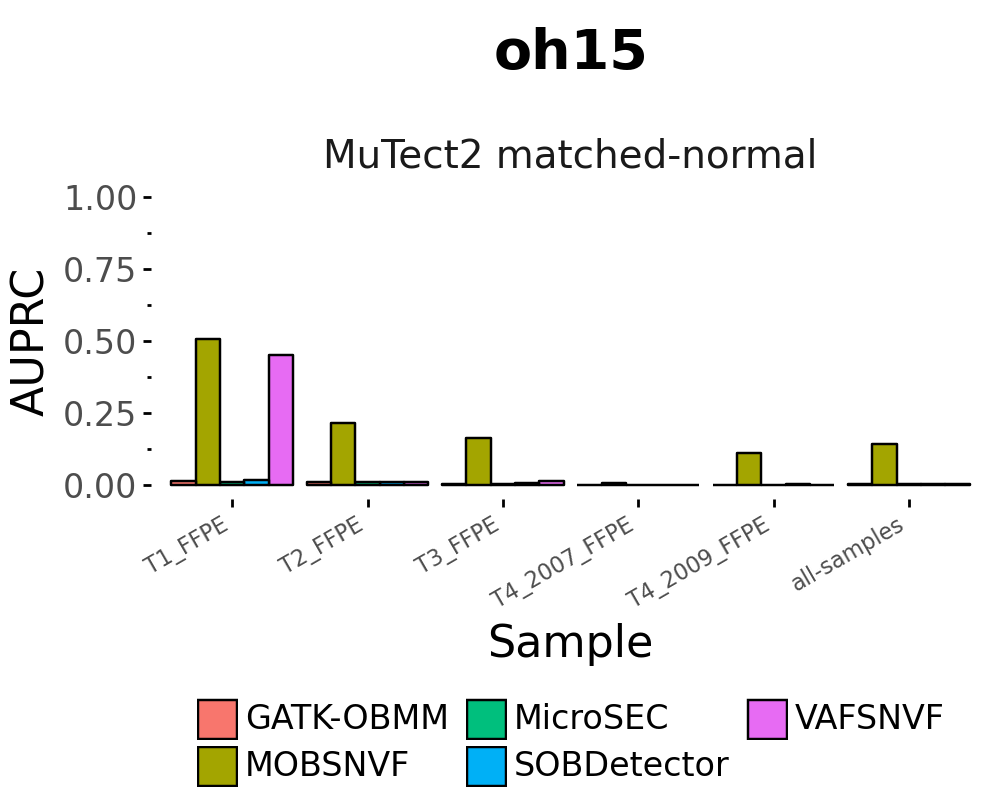

In [283]:
ena_SRP065941_f_f_ct_auprc_barplot = auc_barplot(
	ena_SRP065941_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "oh15",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUPRC",
	text_scale=1,
	legend_rows=2
)

ena_SRP065941_f_f_ct_auprc_barplot.save("ena.SRP065941.auprc.barplot.matched.f-ffpe_f-ff.pdf")
ena_SRP065941_f_f_ct_auprc_barplot

### EGA

sample_name,model,auroc,auprc,wtype
str,str,f64,f64,str
"""all-colon-samples""","""GATK-OBMM""",0.5,0.186203,"""MuTect2 matched-normal"""
"""all-colon-samples""","""MicroSEC""",0.813882,0.400543,"""MuTect2 matched-normal"""
"""all-colon-samples""","""MOBSNVF""",0.930407,0.814924,"""MuTect2 matched-normal"""
"""all-colon-samples""","""SOBDetector""",0.854526,0.42407,"""MuTect2 matched-normal"""
"""all-colon-samples""","""VAFSNVF""",0.311257,0.127587,"""MuTect2 matched-normal"""
…,…,…,…,…
"""FFPE-Liver-Tumoral_B00GXLZ""","""GATK-OBMM""",0.495723,0.017001,"""MuTect2 matched-normal"""
"""FFPE-Liver-Tumoral_B00GXLZ""","""MicroSEC""",0.668842,0.027942,"""MuTect2 matched-normal"""
"""FFPE-Liver-Tumoral_B00GXLZ""","""MOBSNVF""",0.762143,0.377124,"""MuTect2 matched-normal"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 8 x 5 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ega.EGAD00001004066.auroc.barplot.matched.f-ffpe_f-ff.pdf


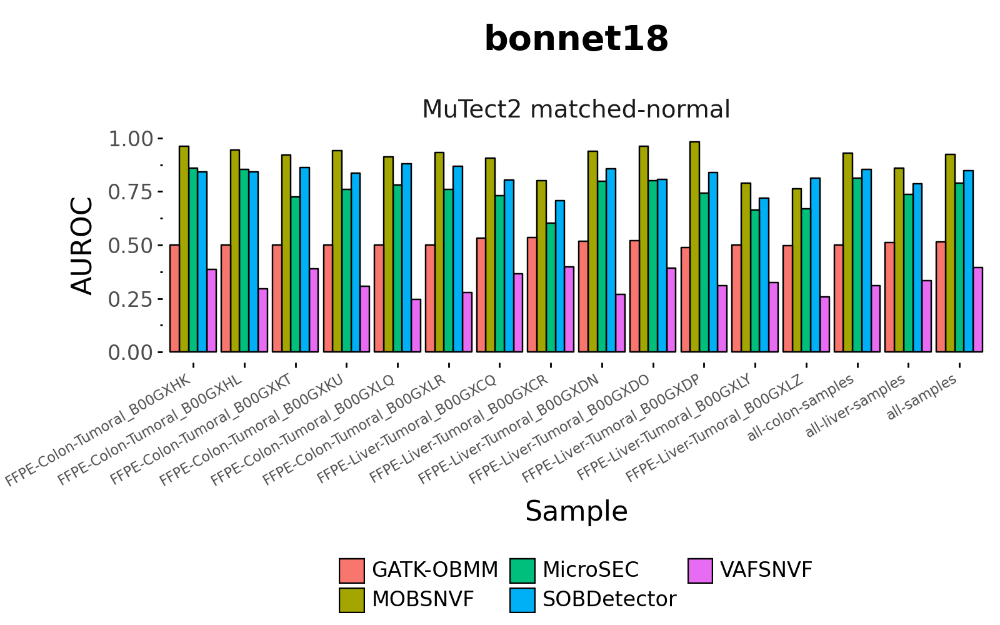

In [284]:
ega_EGAD00001004066_f_f_ct_aucs =  (
    pl.read_csv("ega_EGAD00001004066/ega.EGAD00001004066.matched.f-ffpe_f-ff.tsv", separator="\t")
    .with_columns(wtype = pl.lit("MuTect2 matched-normal"))
    # .filter(~pl.col("sample_name").str.contains("all-"))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)

display(ega_EGAD00001004066_f_f_ct_aucs)

set_option("figure_size", (8, 5))

ega_EGAD00001004066_f_f_ct_auroc_barplot = auc_barplot(
	ega_EGAD00001004066_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "bonnet18",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUROC",
	text_scale=1,
	legend_rows=2
)

ega_EGAD00001004066_f_f_ct_auroc_barplot.save("ega.EGAD00001004066.auroc.barplot.matched.f-ffpe_f-ff.pdf")
ega_EGAD00001004066_f_f_ct_auroc_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 8 x 5 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: ega.EGAD00001004066.auprc.barplot.matched.f-ffpe_f-ff.pdf


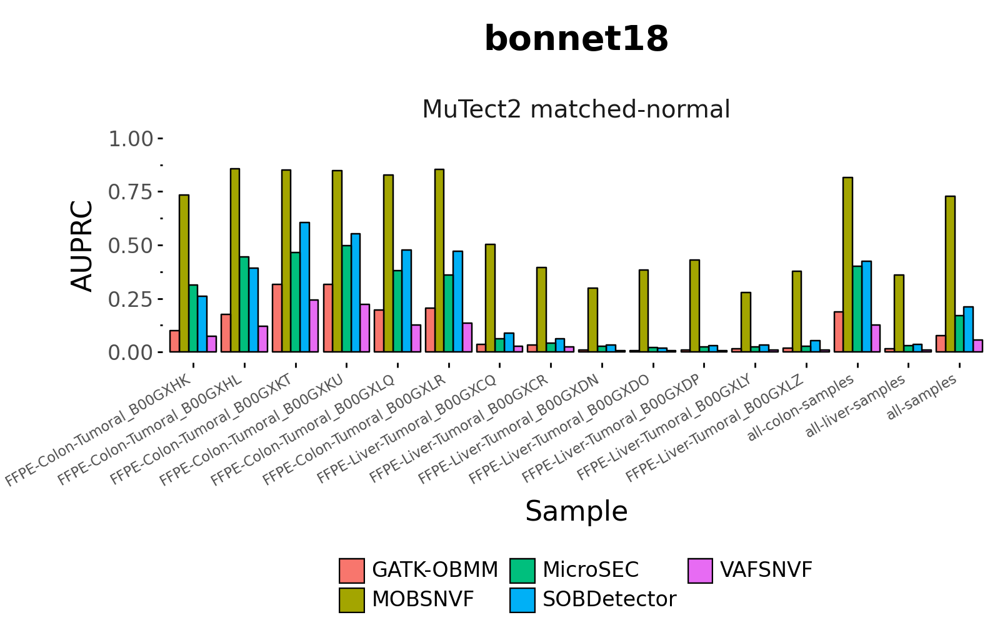

In [285]:
ega_EGAD00001004066_f_f_ct_auprc_barplot = auc_barplot(
	ega_EGAD00001004066_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "bonnet18",
	subtitle = " ",
	x_axis_label="Sample",
	y_axis_label="AUPRC",
	text_scale=1,
	legend_rows=2
)

ega_EGAD00001004066_f_f_ct_auprc_barplot.save("ega.EGAD00001004066.auprc.barplot.matched.f-ffpe_f-ff.pdf")
ega_EGAD00001004066_f_f_ct_auprc_barplot

### SEQC2

sample_name,model,auroc,auprc,wtype
str,str,f64,f64,str
"""all-ffpe-wgs-samples""","""GATK-OBMM""",0.521135,0.965965,"""MuTect2 matched-normal"""
"""all-ffpe-wgs-samples""","""MOBSNVF""",0.679284,0.975858,"""MuTect2 matched-normal"""
"""all-ffpe-wgs-samples""","""SOBDetector""",0.663256,0.972378,"""MuTect2 matched-normal"""
"""all-ffpe-wgs-samples""","""VAFSNVF""",0.890158,0.993841,"""MuTect2 matched-normal"""
"""FFG_GZ_T_1h-A""","""GATK-OBMM""",0.517456,0.965413,"""MuTect2 matched-normal"""
…,…,…,…,…
"""FFG_IL_T_2h""","""MOBSNVF""",0.672313,0.977818,"""MuTect2 matched-normal"""
"""FFG_IL_T_2h""","""SOBDetector""",0.640083,0.973639,"""MuTect2 matched-normal"""
"""FFG_IL_T_2h""","""VAFSNVF""",0.877215,0.993788,"""MuTect2 matched-normal"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: seqc2.ffg.auroc.barplot.matched.f-ffpe_f-ff.pdf


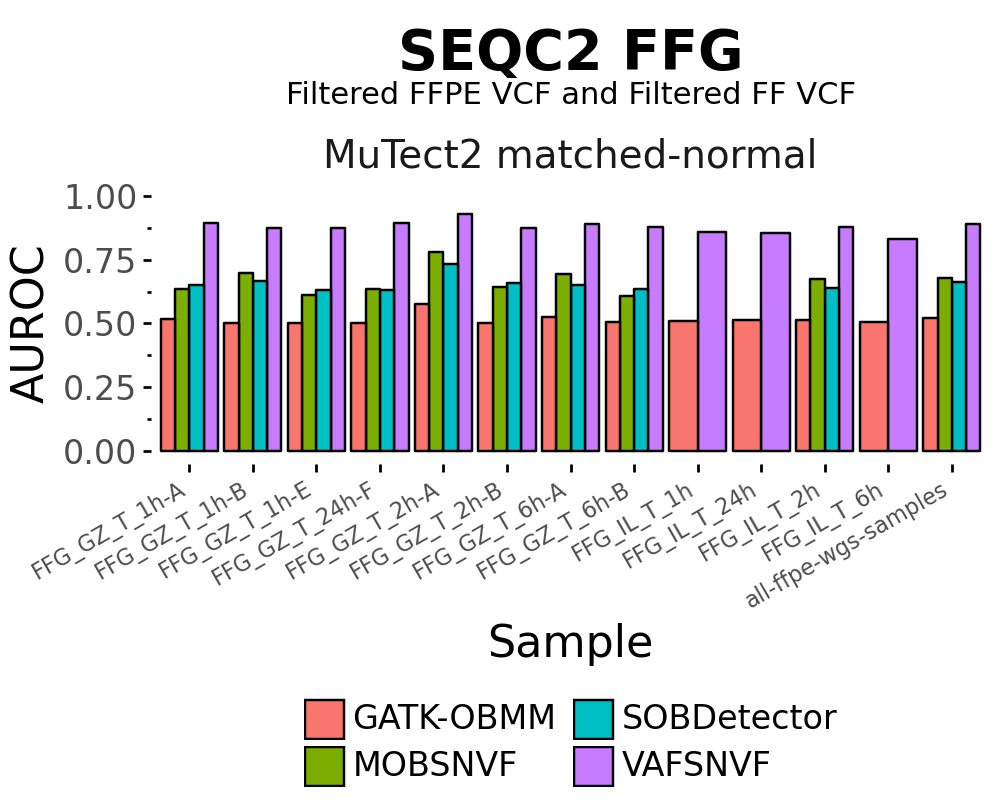

In [286]:
seqc2_ffg_f_f_ct_aucs =  (
    pl.read_csv("seqc2/seqc2.ffg.matched.f-ffpe_f-ff.tsv", separator="\t")
    .with_columns(wtype = pl.lit("MuTect2 matched-normal"))
    # .filter(~pl.col("sample_name").str.contains("all-"))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)

display(seqc2_ffg_f_f_ct_aucs)

set_option("figure_size", (5, 4))

seqc2_ffg_f_uf_ct_auroc_barplot = auc_barplot(
	seqc2_ffg_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "SEQC2 FFG",
	subtitle = "Filtered FFPE VCF and Filtered FF VCF",
	x_axis_label="Sample",
	y_axis_label="AUROC",
	text_scale=1,
	legend_rows=2
)

seqc2_ffg_f_uf_ct_auroc_barplot.save("seqc2.ffg.auroc.barplot.matched.f-ffpe_f-ff.pdf")
seqc2_ffg_f_uf_ct_auroc_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: seqc2.ffg.auprc.barplot.matched.f-ffpe_f-ff.pdf


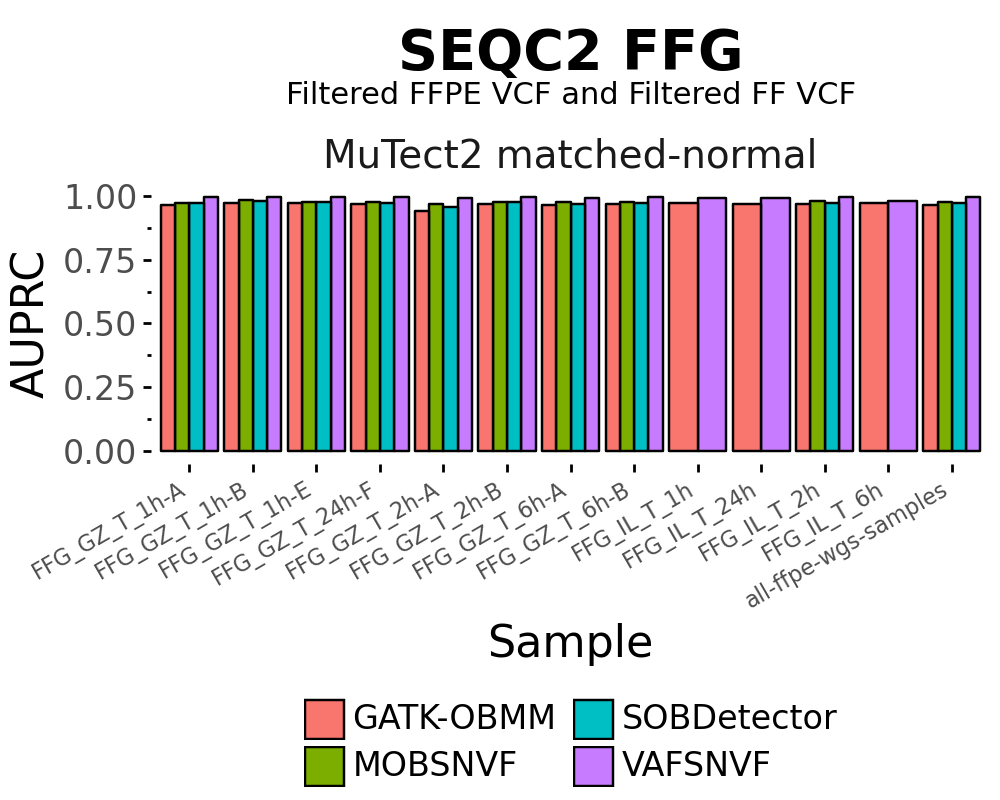

In [287]:
seqc2_ffg_f_uf_ct_auroc_barplot = auc_barplot(
	seqc2_ffg_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "SEQC2 FFG",
	subtitle = "Filtered FFPE VCF and Filtered FF VCF",
	x_axis_label="Sample",
	y_axis_label="AUPRC",
	text_scale=1,
	legend_rows=2
)

seqc2_ffg_f_uf_ct_auroc_barplot.save("seqc2.ffg.auprc.barplot.matched.f-ffpe_f-ff.pdf")
seqc2_ffg_f_uf_ct_auroc_barplot

sample_name,model,auroc,auprc,wtype
str,str,f64,f64,str
"""all-ffpe-wgs-samples""","""GATK-OBMM""",0.530715,0.979379,"""MuTect2 matched-normal"""
"""all-ffpe-wgs-samples""","""MOBSNVF""",0.739132,0.987923,"""MuTect2 matched-normal"""
"""all-ffpe-wgs-samples""","""SOBDetector""",0.71163,0.984715,"""MuTect2 matched-normal"""
"""all-ffpe-wgs-samples""","""VAFSNVF""",0.915612,0.997329,"""MuTect2 matched-normal"""
"""FFG_GZ_T_1h-A""","""GATK-OBMM""",0.523011,0.978302,"""MuTect2 matched-normal"""
…,…,…,…,…
"""FFG_IL_T_2h""","""MOBSNVF""",0.731729,0.989476,"""MuTect2 matched-normal"""
"""FFG_IL_T_2h""","""SOBDetector""",0.674776,0.985396,"""MuTect2 matched-normal"""
"""FFG_IL_T_2h""","""VAFSNVF""",0.906146,0.997486,"""MuTect2 matched-normal"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: seqc2.ffg.auroc.barplot.matched.f-ffpe_uf-ff.pdf


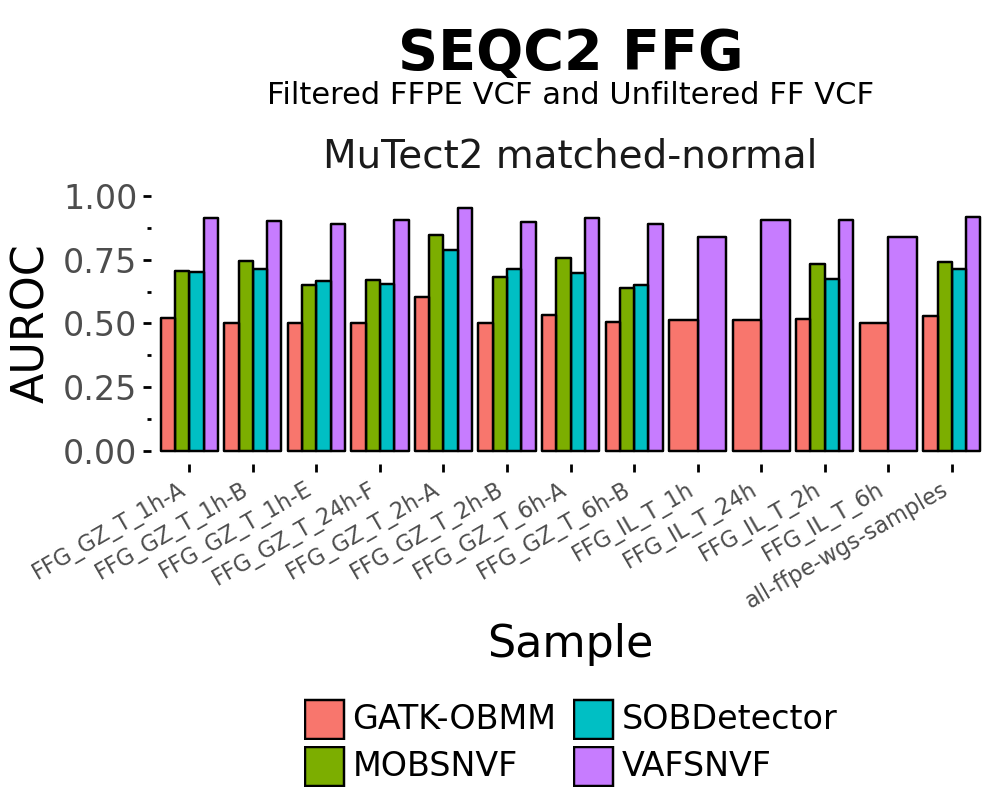

In [288]:
seqc2_ffg_f_uf_ct_aucs =  (
    pl.read_csv("seqc2/seqc2.ffg.matched.f-ffpe_uf-ff.tsv", separator="\t")
    .with_columns(wtype = pl.lit("MuTect2 matched-normal"))
    # .filter(~pl.col("sample_name").str.contains("all-"))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)

display(seqc2_ffg_f_uf_ct_aucs)

set_option("figure_size", (5, 4))

seqc2_ffg_f_uf_ct_auroc_barplot = auc_barplot(
	seqc2_ffg_f_uf_ct_aucs,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "SEQC2 FFG",
	subtitle = "Filtered FFPE VCF and Unfiltered FF VCF",
	x_axis_label="Sample",
	y_axis_label="AUROC",
	text_scale=1,
	legend_rows=2
)

seqc2_ffg_f_uf_ct_auroc_barplot.save("seqc2.ffg.auroc.barplot.matched.f-ffpe_uf-ff.pdf")
seqc2_ffg_f_uf_ct_auroc_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: seqc2.ffg.auprc.barplot.matched.f-ffpe_uf-ff.pdf


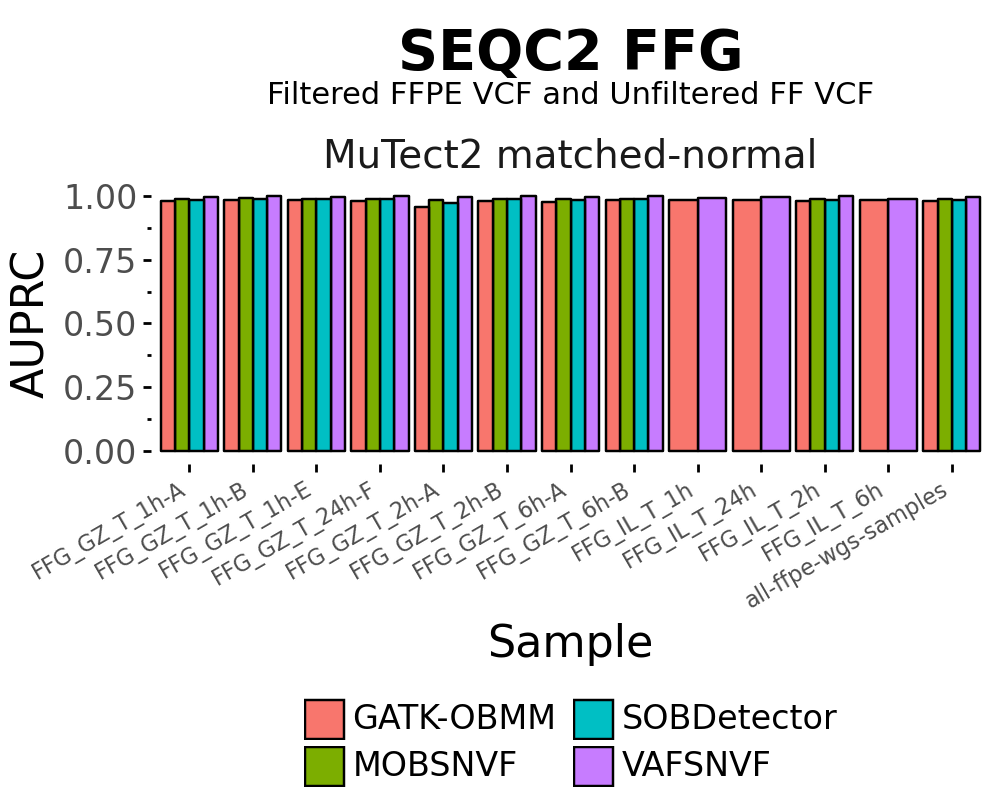

In [289]:
seqc2_ffg_f_uf_ct_auprc_barplot = auc_barplot(
	seqc2_ffg_f_uf_ct_aucs,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "SEQC2 FFG",
	subtitle = "Filtered FFPE VCF and Unfiltered FF VCF",
	x_axis_label="Sample",
	y_axis_label="AUPRC",
	text_scale=1,
	legend_rows=2
)

seqc2_ffg_f_uf_ct_auprc_barplot.save("seqc2.ffg.auprc.barplot.matched.f-ffpe_uf-ff.pdf")
seqc2_ffg_f_uf_ct_auprc_barplot

sample_name,model,auroc,auprc,wtype
str,str,f64,f64,str
"""all-ffpe-wes-samples""","""GATK-OBMM""",0.499509,0.75145,"""MuTect2 matched-normal"""
"""all-ffpe-wes-samples""","""MOBSNVF""",0.849054,0.91995,"""MuTect2 matched-normal"""
"""all-ffpe-wes-samples""","""SOBDetector""",0.790495,0.870931,"""MuTect2 matched-normal"""
"""all-ffpe-wes-samples""","""VAFSNVF""",0.744859,0.86357,"""MuTect2 matched-normal"""
"""FFX_GZ_T_1h_1""","""GATK-OBMM""",0.5,0.865487,"""MuTect2 matched-normal"""
…,…,…,…,…
"""FFX_IL_T_2h_1""","""VAFSNVF""",0.776044,0.798416,"""MuTect2 matched-normal"""
"""FFX_IL_T_6h_1""","""GATK-OBMM""",0.499097,0.781471,"""MuTect2 matched-normal"""
"""FFX_IL_T_6h_1""","""MOBSNVF""",0.850862,0.927852,"""MuTect2 matched-normal"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: seqc2.ffx.auroc.barplot.matched.f-ffpe_f-ff.pdf


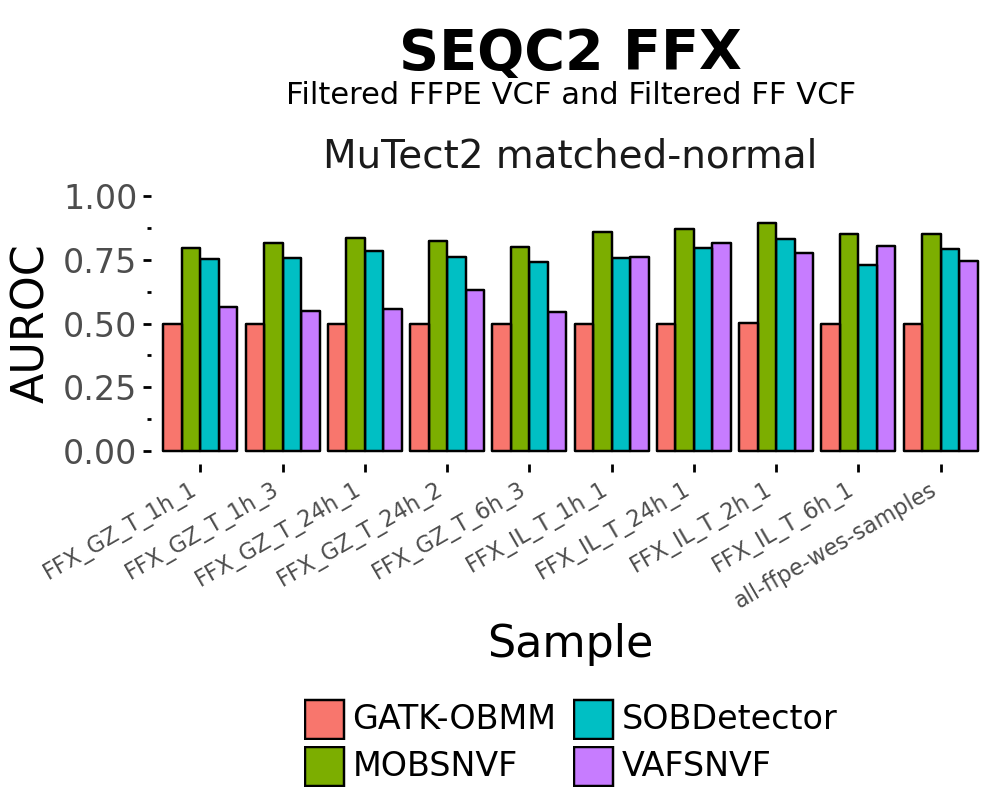

In [290]:
seqc2_ffx_f_f_ct_aucs =  (
    pl.read_csv("seqc2/seqc2.ffx.matched.f-ffpe_f-ff.tsv", separator="\t")
    .with_columns(wtype = pl.lit("MuTect2 matched-normal"))
    # .filter(~pl.col("sample_name").str.contains("all-"))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)

display(seqc2_ffx_f_f_ct_aucs)

set_option("figure_size", (5, 4))

seqc2_ffx_f_f_ct_auroc_barplot = auc_barplot(
	seqc2_ffx_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "SEQC2 FFX",
	subtitle = "Filtered FFPE VCF and Filtered FF VCF",
	x_axis_label="Sample",
	y_axis_label="AUROC",
	text_scale=1,
	legend_rows=2
)

seqc2_ffx_f_f_ct_auroc_barplot.save("seqc2.ffx.auroc.barplot.matched.f-ffpe_f-ff.pdf")
seqc2_ffx_f_f_ct_auroc_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: seqc2.ffx.auprc.barplot.matched.f-ffpe_f-ff.pdf


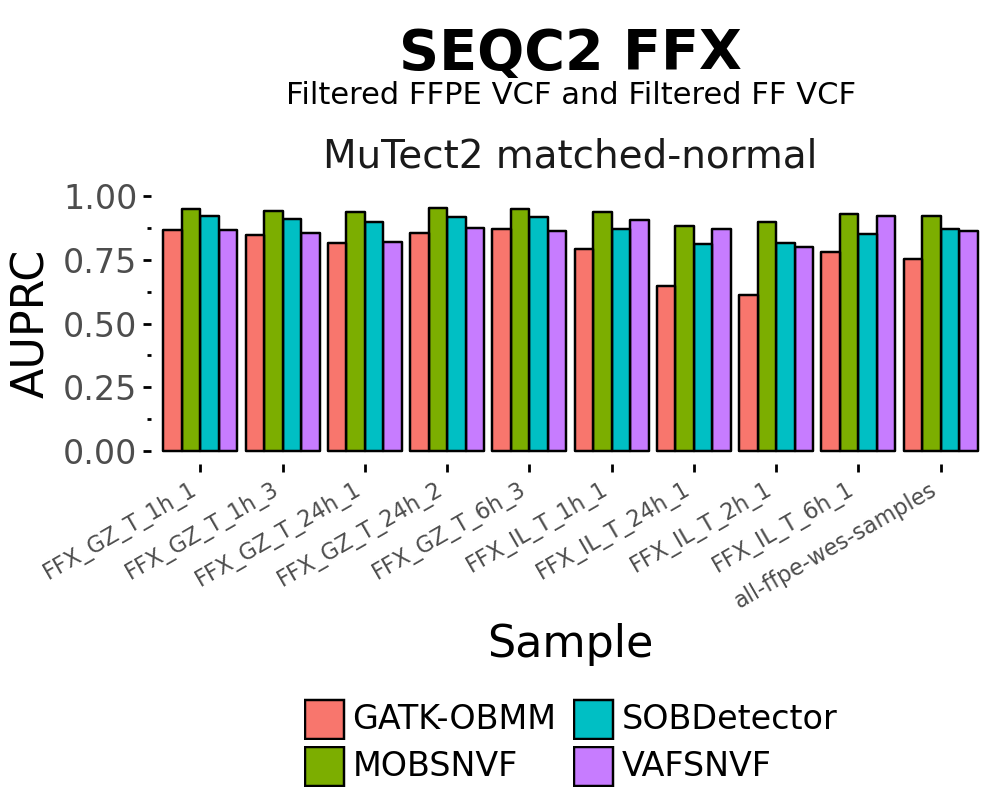

In [291]:
seqc2_ffx_f_f_ct_auprc_barplot = auc_barplot(
	seqc2_ffx_f_f_ct_aucs,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "SEQC2 FFX",
	subtitle = "Filtered FFPE VCF and Filtered FF VCF",
	x_axis_label="Sample",
	y_axis_label="AUPRC",
	text_scale=1,
	legend_rows=2
)

seqc2_ffx_f_f_ct_auprc_barplot.save("seqc2.ffx.auprc.barplot.matched.f-ffpe_f-ff.pdf")
seqc2_ffx_f_f_ct_auprc_barplot

sample_name,model,auroc,auprc,wtype
str,str,f64,f64,str
"""all-ffpe-wes-samples""","""GATK-OBMM""",0.498773,0.792804,"""MuTect2 matched-normal"""
"""all-ffpe-wes-samples""","""MOBSNVF""",0.892534,0.95772,"""MuTect2 matched-normal"""
"""all-ffpe-wes-samples""","""SOBDetector""",0.839107,0.91537,"""MuTect2 matched-normal"""
"""all-ffpe-wes-samples""","""VAFSNVF""",0.728002,0.881602,"""MuTect2 matched-normal"""
"""FFX_GZ_T_1h_1""","""GATK-OBMM""",0.5,0.904425,"""MuTect2 matched-normal"""
…,…,…,…,…
"""FFX_IL_T_2h_1""","""VAFSNVF""",0.760177,0.810984,"""MuTect2 matched-normal"""
"""FFX_IL_T_6h_1""","""GATK-OBMM""",0.499145,0.826026,"""MuTect2 matched-normal"""
"""FFX_IL_T_6h_1""","""MOBSNVF""",0.901452,0.964679,"""MuTect2 matched-normal"""


/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: seqc2.ffx.auroc.barplot.matched.uf-ffpe_f-ff.pdf


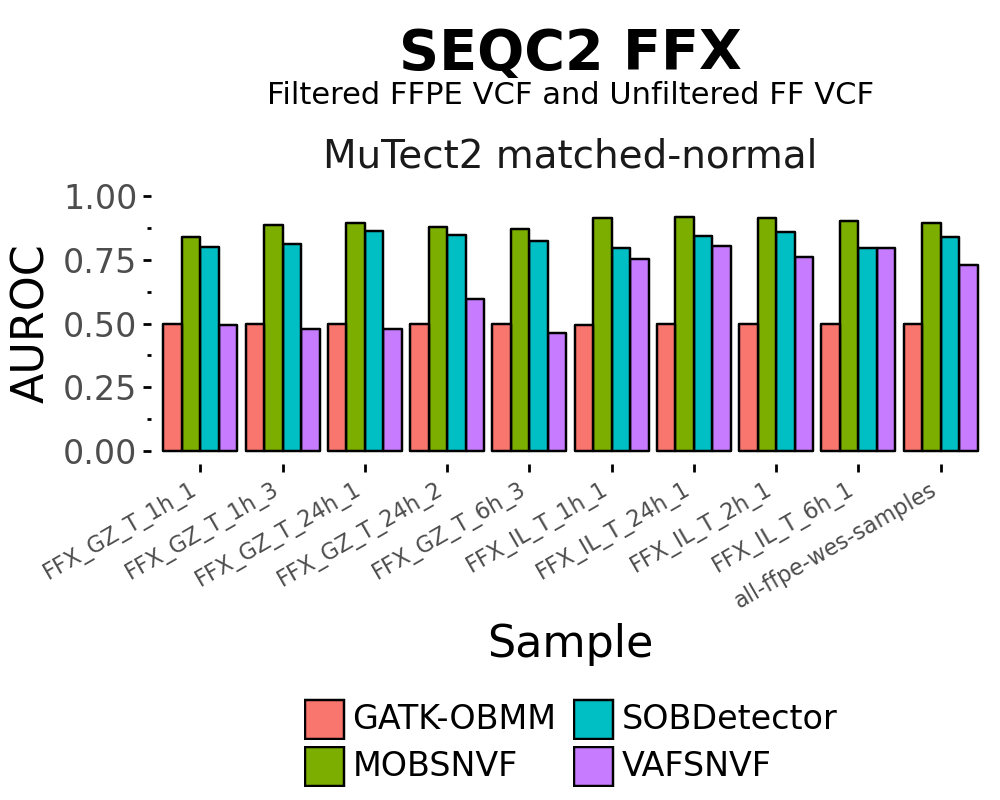

In [292]:
seqc2_ffx_f_uf_ct_aucs =  (
    pl.read_csv("seqc2/seqc2.ffx.matched.f-ffpe_uf-ff.tsv", separator="\t")
    .with_columns(wtype = pl.lit("MuTect2 matched-normal"))
    # .filter(~pl.col("sample_name").str.contains("all-"))
    .with_columns(pl.col("model").map_elements(lambda x : stylized_model_names.get(x, x), return_dtype=str))
)

display(seqc2_ffx_f_uf_ct_aucs)

set_option("figure_size", (5, 4))

seqc2_ffx_f_uf_ct_auroc_barplot = auc_barplot(
	seqc2_ffx_f_uf_ct_aucs,
	x_col="sample_name",
	y_col="auroc",
	model_col="model",
	facet_col="wtype",
	title = "SEQC2 FFX",
	subtitle = "Filtered FFPE VCF and Unfiltered FF VCF",
	x_axis_label="Sample",
	y_axis_label="AUROC",
	text_scale=1,
	legend_rows=2
)

seqc2_ffx_f_uf_ct_auroc_barplot.save("seqc2.ffx.auroc.barplot.matched.uf-ffpe_f-ff.pdf")
seqc2_ffx_f_uf_ct_auroc_barplot

/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:630: PlotnineWarning: Saving 5 x 4 in image.
/home/moyukh/miniconda3/envs/ffpe-bench/lib/python3.12/site-packages/plotnine/ggplot.py:631: PlotnineWarning: Filename: seqc2.ffx.auprc.barplot.matched.uf-ffpe_f-ff.pdf


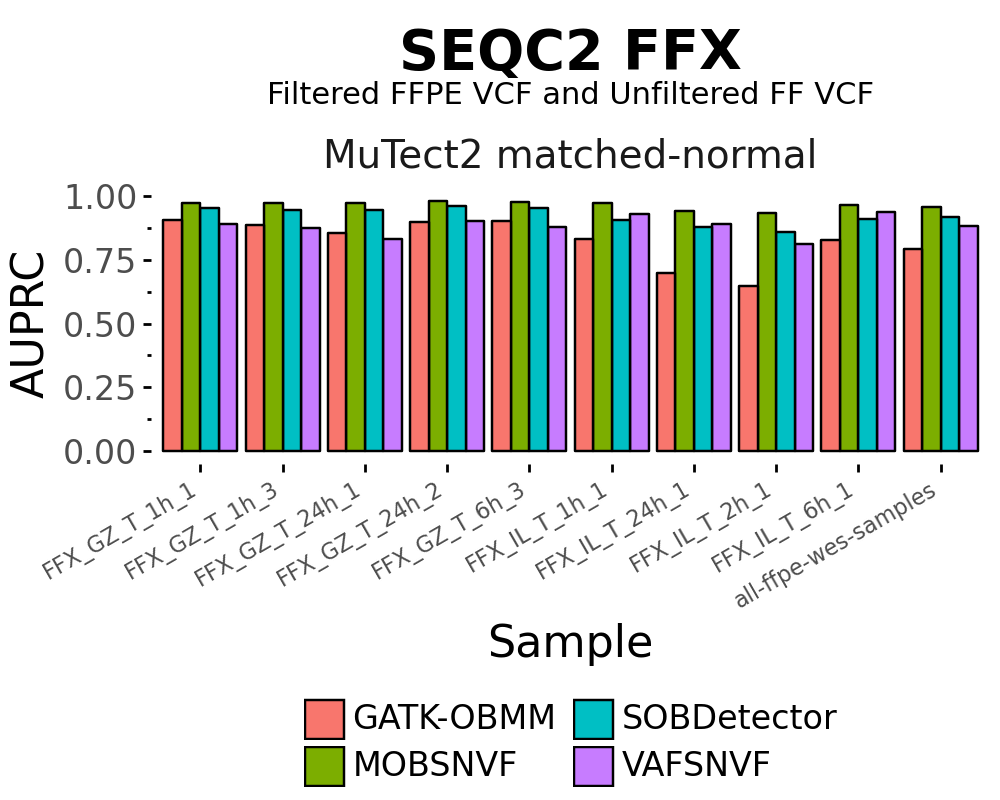

In [293]:
seqc2_ffx_f_uf_ct_auprc_barplot = auc_barplot(
	seqc2_ffx_f_uf_ct_aucs,
	x_col="sample_name",
	y_col="auprc",
	model_col="model",
	facet_col="wtype",
	title = "SEQC2 FFX",
	subtitle = "Filtered FFPE VCF and Unfiltered FF VCF",
	x_axis_label="Sample",
	y_axis_label="AUPRC",
	text_scale=1,
	legend_rows=2
)

seqc2_ffx_f_uf_ct_auprc_barplot.save("seqc2.ffx.auprc.barplot.matched.uf-ffpe_f-ff.pdf")
seqc2_ffx_f_uf_ct_auprc_barplot